# This is my technical paper, walking through my data cleaning, analysis and model creation

The main question to be answered is: What impacts house prices in London, I will also take a look at regional affordability over time. 

- To begin with I imported my libaries, loaded my dataset into a dataframe after this I tried to get a fell of the the shape of the data, nulls and datatypes

In [1]:
#Basic Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np 
import seaborn as sns
import os 
import plotly.express as px
import geopandas as gpd
import pickle
%matplotlib inline

#Viz Libraries
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px

#sklearn
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.dummy import DummyRegressor
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler


In [2]:
hp = pd.read_csv('kaggle_london_house_price_data.csv')

## Null removal

This is a summary of the columns, with its name, number of null and what I decided to do with it: 

These were the columns that I removed due to not needing them for my analysis: 

- history_numericChange: 180219
  
- rentEstimate_lowerPrice: 1741

- rentEstimate_currentPrice: 1741 

- rentEstimate_upperPrice: 1741 

- saleEstimate_confidenceLevel: 640  

- saleEstimate_upperPrice: 40 

- saleEstimate_ingestedAt: 640 

- saleEstimate_valueChange.numericChange: 640

- saleEstimate_valueChange.saleDate: 640 

- saleEstimate_valueChange.percentageChange: 640

- saleEstimate_lowerPrice: 640 

- saleEstimate_currentPrice: 640 

These were the columns that I removed the rows with blanks, as I need them for my analysis especially propertyType, which I ended up using to derive the missing information for bedrooms, bathrooms and living rooms:

- floorAreaSqM: 25210

- tenure: 11512 

- propertyType: 1136 

Finally I removed the below as too much information was missing, ad with the EPC it would be pointless trying to guess: 

- history_percentageChange: 180219

- currentEnergyRating: 84526









- country: 0 - removed as there is only one country

In [3]:
hp = hp.drop(columns=['history_percentageChange','history_numericChange','currentEnergyRating','rentEstimate_lowerPrice','rentEstimate_currentPrice',
                     'rentEstimate_upperPrice','saleEstimate_confidenceLevel','saleEstimate_upperPrice','saleEstimate_ingestedAt',
                      'saleEstimate_valueChange.numericChange','saleEstimate_valueChange.saleDate','saleEstimate_valueChange.percentageChange',
                     'saleEstimate_lowerPrice','saleEstimate_currentPrice','country'])

In [4]:
hp=hp.dropna(subset=['propertyType','tenure','floorAreaSqM'])

## Remaining Nulls: 

Following the removal of the above columns I was left with the following nulls

- bathrooms: 60025
- livingRooms: 41800
- bedrooms: 26725

I decided the best way to deal with these was to work out averages based on the type of property, another way I could have done this, which I considered was to base it off of floorAreaSqM, however having worked in property sector I felt basing it on property type made more sense

After looking at the different types of property in my dataset I decided to group them into the below bins:

In [5]:
pt=[]
for prop in hp.propertyType:
    if prop in ['End Terrace House','Mid Terrace House', 'Terrace Property','Terraced','Mid Terrace Property','End Terrace Property']:
        pt.append('Terrace House')
        
    elif prop in ['Semi-Detached House','Semi-Detached Property']:
        pt.append('Semi-Detached House')

    elif prop in ['Detached House']:
        pt.append('Detached House')

    elif prop in ['Converted Flat','Flat/Maisonette']:
        pt.append('Converted Flat')
    
    elif prop in ['Bungalow Property','Detached Bungalow','Semi-Detached Bungalow', 'Mid Terrace Bungalow','Terraced Bungalow','End Terrace Bungalow']:
       pt.append('Bungalow')
    else:
        pt.append('Flat')
hp['summary_propertyType']=pt

hp = hp.drop(columns=['propertyType'])

- Before allocating the average number of bedrooms, bathrooms and living rooms based on proeperty type, I explored history_price grouped by proeprty type in order to remove outliers. for this I used a box plot

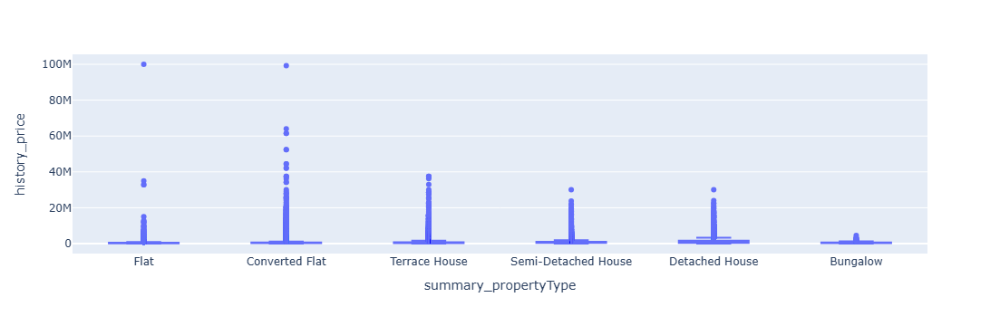

In [6]:
fig = px.box(hp, x='summary_propertyType', y="history_price")
fig.show()

- As we can see, all of the properties have outliers to various degrees, In order to handle these I decided to look at the 95th quartile for each property type and then removed anthing bigger than that, the result of which we can see in the second box plot, while still having some outliers it is significatly better than it was and it is quite normal for there to be some super expensise property. 

In [7]:
hp.groupby('summary_propertyType')['history_price'].quantile(0.95)

tq = hp.groupby('summary_propertyType')['history_price'].transform(lambda x: x.quantile(0.95))
hp_2 = hp[hp['history_price'] <= tq]
hp=hp_2

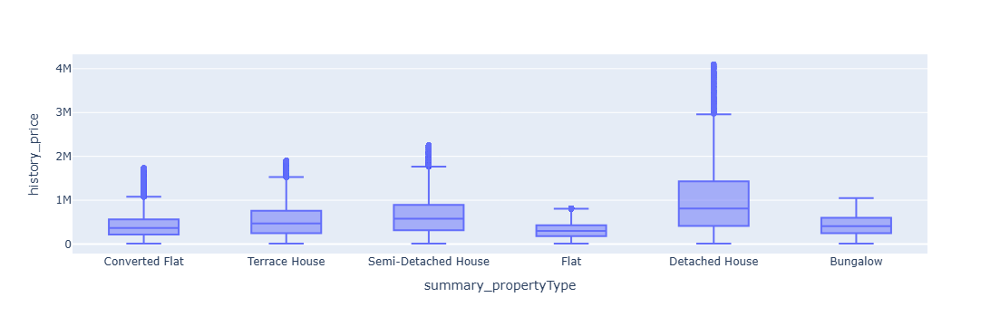

In [8]:
fig = px.box(hp_2, x='summary_propertyType', y="history_price")
fig.show()

## Filling in the nulls

To fill in the nulls, I explored the averages of bedrooms, bathrooms and livingrooms for each property sub-category then created dictionary of all of the averages, afterwhich I used a function to allocate these values to the nulls. 

In [9]:
hp.groupby('summary_propertyType')[['bathrooms','bedrooms','livingRooms']].agg(['count','mean','min','max']).round(0)

bathrooms                bedrooms                 \
                         count mean  min  max    count mean  min  max   
summary_propertyType                                                    
Bungalow                  1013  1.0  1.0  4.0     1095  2.0  1.0  5.0   
Converted Flat           93370  1.0  1.0  7.0   101923  2.0  1.0  9.0   
Detached House            7856  2.0  1.0  8.0     8559  4.0  1.0  9.0   
Flat                     90448  1.0  1.0  5.0   101256  2.0  1.0  9.0   
Semi-Detached House      24593  2.0  1.0  7.0    27050  4.0  1.0  9.0   
Terrace House            94461  2.0  1.0  8.0   103037  3.0  1.0  9.0   

                     livingRooms                 
                           count mean  min  max  
summary_propertyType                             
Bungalow                    1037  1.0  1.0  4.0  
Converted Flat             96230  1.0  1.0  5.0  
Detached House              8185  2.0  1.0  6.0  
Flat                       98797  1.0  1.0  4.0  
Semi-Detached House        25910  2.0  1.0  6.0  
Terrace House              98939  2.0  1.0  7.0

In [10]:
mean_values = {'Bungalow': {'bathrooms': 1, 'bedrooms': 2, 'livingRooms': 1},
    'Converted Flat': {'bathrooms': 1, 'bedrooms': 2, 'livingRooms': 1},
    'Detached House': {'bathrooms': 2, 'bedrooms': 4, 'livingRooms': 2},
    'Flat': {'bathrooms': 1, 'bedrooms': 2, 'livingRooms': 1},
    'Semi-Detached House': {'bathrooms': 2, 'bedrooms': 4, 'livingRooms': 2},
    'Terrace House': {'bathrooms': 2, 'bedrooms': 3, 'livingRooms': 2}}

In [11]:
#which I used to in conjunction with a function to fill in the nulls

def fill_missing_values(row):
    property_type = row['summary_propertyType']
    if property_type in mean_values:
        for column in ['bathrooms', 'bedrooms', 'livingRooms']:
            if pd.isnull(row[column]):
                row[column] = mean_values[property_type][column]
    return row

hp = hp.apply(fill_missing_values, axis=1)

# which removed the remaining nulls 
#hp.isnull().sum().sort_values(ascending = False)

- At this point I decided to do a little cleaning up, making the column names more readable, removing the outliers from tenure and creating a new column for price per square meter, from my time in property I know its a key metric. It wont be used for my model, as it would be cheating, however it will be used in my later analysis in tableau. 

In [12]:
hp.rename(columns={
    'fullAddress': 'address',
    'postcode': 'postcode',
    'outcode': 'outcode',
    'latitude': 'latitude',
    'longitude': 'longitude',
    'bathrooms': 'bathrooms',
    'bedrooms': 'bedrooms',
    'floorAreaSqM': 'floor_area_sqm',
    'livingRooms': 'living_rooms',
    'tenure': 'tenure',
    'history_date': 'history_date',
    'history_price': 'history_price',
    'summary_propertyType': 'property_type'
}, inplace=True)

In [13]:
hp = hp[hp.tenure != 'Feudal']

In [14]:
hp = hp[hp.tenure != 'Shared']

In [15]:
hp['price_per_sqm']=round((hp['history_price'])/(hp['floor_area_sqm']),0)

## Geopandas

Another consideration for predicting house prices, is the accessability of public transport and regonality

To explore this I used GeoPandas, to create a geodataframe, I started by finding the shapefiles for all of the London Boroughs, defined the file paths for the shapefiles and saving their locations in a list then Concatenated all GeoDataFrames into a single GeoDataFrame and did some cleaning. 

In [16]:
shapefile_paths = [
    'shapefiles/Barking and Dagenham.shp',
    'shapefiles/Barnet.shp',
    'shapefiles/Bexley.shp',
    'shapefiles/Brent.shp',
    'shapefiles/Bromley.shp',
    'shapefiles/Camden.shp',
    'shapefiles/Croydon.shp',
    'shapefiles/Ealing.shp',
    'shapefiles/Enfield.shp',
    'shapefiles/Greenwich.shp',
    'shapefiles/Hackney.shp',
    'shapefiles/Hammersmith and Fulham.shp',
    'shapefiles/Haringey.shp',
    'shapefiles/Harrow.shp',
    'shapefiles/Havering.shp',
    'shapefiles/Hillingdon.shp',
    'shapefiles/Hounslow.shp',
    'shapefiles/Islington.shp',
    'shapefiles/Kensington and Chelsea.shp',
    'shapefiles/Kingston upon Thames.shp',
    'shapefiles/Lambeth.shp',
    'shapefiles/Lewisham.shp',
    'shapefiles/Merton.shp',
    'shapefiles/Newham.shp',
    'shapefiles/Redbridge.shp',
    'shapefiles/Richmond upon Thames.shp',
    'shapefiles/Southwark.shp',
    'shapefiles/Sutton.shp',
    'shapefiles/Tower Hamlets.shp',
    'shapefiles/Waltham Forest.shp',
    'shapefiles/Wandsworth.shp',
    'shapefiles/Westminster.shp',
    'shapefiles/City of London.shp'
]


gdfs = [gpd.read_file(path) for path in shapefile_paths]

london_boroughs = gpd.GeoDataFrame(pd.concat(gdfs, ignore_index=True))

london_boroughs.head(1)

london_boroughs = london_boroughs[['lad22nm','geometry']]

london_boroughs.rename(columns={'lad22nm': 'borough'}, inplace=True)

- Next up I grouped all the outcodes in London into regions and droped 'Outer London', as there was only one property in that class, I then droped the postcode and address columns, as I wont be using these going forward. 

In [17]:
region=[]
for code in hp.outcode:
    
    if code.startswith('EC'):
        region.append('EC')
        
    elif code.startswith('NW'):
        region.append('NW')

    elif code.startswith('SE'):
        region.append('SE')

    elif code.startswith('SW'):
        region.append('SW')

    elif code.startswith('WC'):
        region.append('WC')

    elif code.startswith('E'):
        region.append('E')
        
    elif code.startswith('N'):
        region.append('N')

    elif code.startswith('W'):
        region.append('W')

    else:
        region.append('Outer_London')

hp['region']=region
hp = hp[hp['region'] != 'Outer_London']

## Boroughs

Now that we had regions setup, I wanted to look at creating two columns, one that allocated the borough name and another which had its closest station in meters. to each property sale. In order to get this information all the data frames were in the same CRS,  and london boroughs df were in the same format, once that was achived I joined the london_boroughs dataframe with my main hp dataframe on the coordinates which brought over the name of the borugh the property was in.

In [18]:
stations=pd.read_csv('Stations_20220221.csv')
df = gpd.GeoDataFrame(stations,geometry=gpd.points_from_xy(stations.x,stations.y,crs='EPSG:4326'))
shapefile_=london_boroughs.to_crs(df.crs)
stations_gdf=gpd.sjoin(df,shapefile_,how='left',predicate='within',rsuffix='borough')
hp_gp = gpd.GeoDataFrame(hp,geometry=gpd.points_from_xy(hp.longitude,hp.latitude,crs='EPSG:4326'))
hp_gp2=gpd.sjoin(hp_gp,shapefile_,how='left',predicate='within',rsuffix='borough')
hp = hp_gp2.drop(columns=['address', 'postcode', 'index_borough'])

## Station distance

Now that we have the borough information, I managed to get the closest station distance using geopandas to compare coordinate values in the stations df and hp. which extracted the distance to the nearest station in meters.

In [19]:
hp = hp.to_crs(epsg=27700)
stations_gdf = stations_gdf.to_crs(epsg=27700)

distance_station = hp.sjoin_nearest(stations_gdf, distance_col="distances")
distance_station[['distances']]

hp['distance_station_m']= round(distance_station[['distances']],2)


- At this point we are nearing the end of the data cleaning phase, but there were still a few things left to do, namely, changing history_date to datetime, removing nulls in borough and dealing with my categorical variable, to be ready to make a model by encoding them.  

In [20]:
hp=hp.dropna(subset=['borough'])

In [21]:
hp["history_date"] = pd.to_datetime(hp["history_date"])
hp["Year"] = hp["history_date"].dt.year
hp["Month"] = hp["history_date"].dt.month

In [22]:
dummies = pd.get_dummies(hp[['property_type', 'region']], dtype=int)
hp_encoded = pd.concat([hp, dummies], axis=1, copy=False)
hp = hp_encoded

## Correlations

Now that we had our data clean and columns encoded as needed, I wanted to see how correlated the data was to my target, which in this case is history_price. To do this I created a dataframe with all my variables, and looked at the correlations, the heat map was a bit full

In [23]:
feats=hp[['history_price','bathrooms', 'bedrooms','floor_area_sqm', 'living_rooms',
       'distance_station_m', 'Month', 'region_E', 'region_EC',
       'region_N', 'region_NW', 'region_SE','region_SW', 'region_W', 'region_WC', 'property_type_Bungalow',
       'property_type_Converted Flat', 'property_type_Detached House',
       'property_type_Flat', 'property_type_Semi-Detached House',
       'property_type_Terrace House']]

In [24]:
feats.corr()

,history_price,bathrooms,bedrooms,floor_area_sqm,living_rooms,distance_station_m,Month,region_E,region_EC,region_N,...,region_SE,region_SW,region_W,region_WC,property_type_Bungalow,property_type_Converted Flat,property_type_Detached House,property_type_Flat,property_type_Semi-Detached House,property_type_Terrace House
history_price,1.000000,0.411882,0.421721,0.539119,0.316076,-0.084281,-0.000419,-0.085639,0.011697,0.026893,...,-0.161469,0.116647,0.104336,0.011935,-0.005415,-0.065692,0.242684,-0.254686,0.154859,0.147444
bathrooms,0.411882,1.000000,0.562006,0.621992,0.380586,-0.016448,-0.000531,-0.038343,-0.032124,0.019171,...,-0.104819,0.093057,0.045041,-0.038025,-0.016325,-0.170406,0.188321,-0.223597,0.181473,0.229013
bedrooms,0.421721,0.562006,1.000000,0.788733,0.519822,0.135479,-0.002617,-0.019328,-0.097149,0.068686,...,-0.016925,0.054108,-0.051374,-0.068820,-0.001395,-0.364187,0.219279,-0.330066,0.322987,0.439185
floor_area_sqm,0.539119,0.621992,0.788733,1.000000,0.585998,0.073721,-0.001339,-0.054319,-0.063725,0.069502,...,-0.059007,0.075031,-0.002009,-0.066878,-0.003970,-0.293203,0.297287,-0.334694,0.307834,0.353235
living_rooms,0.316076,0.380586,0.519822,0.585998,1.000000,0.103164,0.000762,0.002883,-0.061946,0.084235,...,-0.000049,-0.023920,-0.035914,-0.050644,-0.007081,-0.304226,0.225422,-0.280037,0.287065,0.347460
distance_station_m,-0.084281,-0.016448,0.135479,0.073721,0.103164,1.000000,0.004840,-0.150242,-0.101995,-0.093068,...,0.390270,0.023157,-0.185052,-0.090006,0.042019,-0.175432,0.054588,-0.057869,0.194473,0.100807
Month,-0.000419,-0.000531,-0.002617,-0.001339,0.000762,0.004840,1.000000,-0.004047,-0.000267,0.005999,...,0.009632,-0.003048,-0.010166,-0.001295,-0.003295,-0.008521,-0.000807,0.007884,0.002965,-0.000051
region_E,-0.085639,-0.038343,-0.019328,-0.054319,0.002883,-0.150242,-0.004047,1.000000,-0.058802,-0.181957,...,-0.260859,-0.214253,-0.134967,-0.049815,0.007590,-0.061641,-0.019443,0.034092,-0.017572,0.045885
region_EC,0.011697,-0.032124,-0.097149,-0.063725,-0.061946,-0.101995,-0.000267,-0.058802,1.000000,-0.063714,...,-0.091343,-0.075023,-0.047260,-0.017443,-0.007727,0.099643,-0.021839,0.013868,-0.041162,-0.084153
region_N,0.026893,0.019171,0.068686,0.069502,0.084235,-0.093068,0.005999,-0.181957,-0.063714,1.000000,...,-0.282651,-0.232151,-0.146242,-0.053977,-0.003672,-0.069135,0.020671,-0.015411,0.012280,0.072893


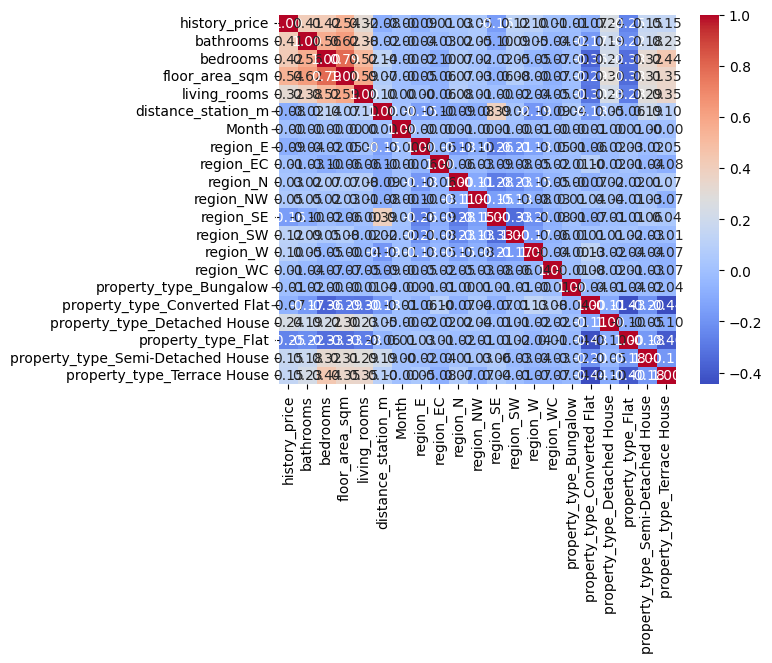

In [25]:
correlation_matrix = feats.corr()
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm")
plt.show()

We can see that bathrooms, bedrooms, floor_area_sqm	and living_rooms had the highest scores. However nothing was particularly high, therefore I decided to see what would happen using them all, as a baseline I used a simple DummyRegressor as you can see the results are lacking, following this we changed to Random Forest Regressor and also used a scaler, Model: 1

## Baseline Model

In [26]:
# Setting features and target

X = hp[['Month', 'distance_station_m', 'bathrooms', 'bedrooms', 'living_rooms', 'floor_area_sqm', 'region_E', 'region_EC', 'region_N', 'region_NW',
        'region_SE', 'region_SW', 'region_W', 'region_WC', 'property_type_Bungalow', 'property_type_Converted Flat','property_type_Detached House', 
        'property_type_Flat','property_type_Semi-Detached House', 'property_type_Terrace House']]

y = hp['history_price']

# Split into train/test

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, stratify=hp['region'])

# Initialise Random Forest

dummy = DummyRegressor(strategy="mean")
dummy.fit(X_train, y_train)

# Make predictions 
y_train_pred = dummy.predict(X_train)
y_test_pred  = dummy.predict(X_test)

# Results
train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
train_r2   = r2_score(y_train, y_train_pred)
test_rmse  = np.sqrt(mean_squared_error(y_test, y_test_pred))
test_r2    = r2_score(y_test, y_test_pred)

print(f"Training RMSE: {train_rmse:.2f}")
print(f"Training R²:   {train_r2:.2f}")
print(f"Testing RMSE:  {test_rmse:.2f}")
print(f"Testing R²:    {test_r2:.2f}")

Training RMSE: 374771.65
Training R²:   0.00
Testing RMSE:  380357.86
Testing R²:    -0.00


## Model: 1

- As mentioned above here we added a scaler, in order to make sure all features had a similar inpact on the results.

- I also changed to RandomForest as the regressor, this is due to it's overall robustness , as I will be using high-dimensionalality as well as its predictive abilities and ability to handle non-linear relationships

In [27]:
X = hp[['Month', 'distance_station_m', 'bathrooms', 'bedrooms', 'living_rooms', 'floor_area_sqm', 'region_E', 'region_EC', 'region_N', 'region_NW', 
        'region_SE', 'region_SW', 'region_W', 'region_WC', 'property_type_Bungalow', 'property_type_Converted Flat', 'property_type_Detached House', 
        'property_type_Flat', 'property_type_Semi-Detached House', 'property_type_Terrace House']]

y = hp['history_price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, stratify=hp['region'])

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=1, max_depth=8, min_weight_fraction_leaf=0.00001, max_features=21)
model.fit(X_train_scaled, y_train)
y_train_pred = model.predict(X_train_scaled)
y_test_pred  = model.predict(X_test_scaled)

train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
train_r2   = r2_score(y_train, y_train_pred)
test_rmse  = np.sqrt(mean_squared_error(y_test, y_test_pred))
test_r2    = r2_score(y_test, y_test_pred)

print(f"Training RMSE: {train_rmse:.2f}")
print(f"Training R²:   {train_r2:.2f}")
print(f"Testing RMSE:  {test_rmse:.2f}")
print(f"Testing R²:    {test_r2:.2f}")

Training RMSE: 291973.70
Training R²:   0.39
Testing RMSE:  292978.31
Testing R²:    0.41


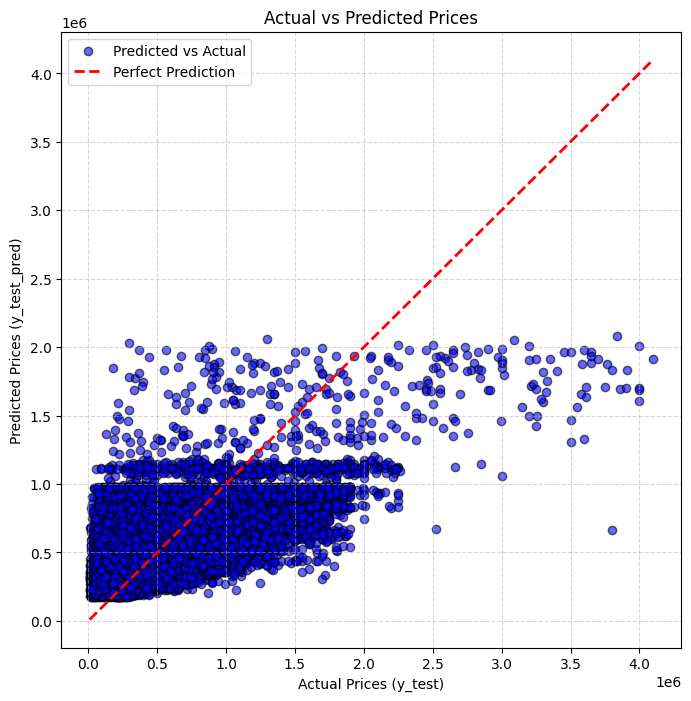

In [28]:
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_test_pred, alpha=0.6, edgecolors='k', color='blue', label="Predicted vs Actual")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2, label="Perfect Prediction")
plt.title("Actual vs Predicted Prices")
plt.xlabel("Actual Prices (y_test)")
plt.ylabel("Predicted Prices (y_test_pred)")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

## Initial findings

As we can see the original model, wasnt the best in the world, after many differnt combinations, I decided that the issue was more likely than not a lack of external information. So after some digging around I decided two add two additional columns, the first beign a metric for inflation, I used CPI and the median household income for each borough, both these datasets came from the ONS, they needed a little tweaking but this was mainly just transposing. After dealing with the dtypes and a little cleaning, I joined them onto my hp df and re-ran my model, with the additional columns. Model: 2

In [29]:
cpi=pd.read_csv('CPI-Monthly.csv')
cpi["date"] = pd.to_datetime(cpi["date"])
cpi['date_m'] = cpi['date'].dt.strftime('%Y-%m')
cpi = cpi.drop(columns=['date'])
hp['date_m'] = hp['history_date'].dt.strftime('%Y-%m')
result = pd.merge(hp, cpi, on="date_m")
hp = result

C:\Users\Will's PC\AppData\Local\Temp\ipykernel_21656\4091343021.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.



In [30]:
avg_income = pd.read_csv('income_london.csv')
df_merged = pd.merge(hp, avg_income, on=['borough', 'Year'],how='left')
hp=df_merged

## Model: 2

In [31]:
X = hp[['Month', 'distance_station_m', 'bathrooms', 'bedrooms', 'living_rooms', 'floor_area_sqm', 'avg_income','region_E', 'region_EC', 'region_N', 
        'region_NW', 'region_SE', 'region_SW', 'region_W', 'region_WC', 'property_type_Bungalow', 'property_type_Converted Flat',
        'property_type_Detached House', 'property_type_Flat', 'property_type_Semi-Detached House', 'property_type_Terrace House', 'cpi']]

y = hp['history_price']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42, stratify=hp['region'])

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

model = RandomForestRegressor(n_estimators=100, random_state=42, n_jobs=1, max_depth=8, min_weight_fraction_leaf=0.00001, max_features=21)
model.fit(X_train_scaled, y_train)
y_train_pred = model.predict(X_train_scaled)
y_test_pred  = model.predict(X_test_scaled)

train_rmse = np.sqrt(mean_squared_error(y_train, y_train_pred))
train_r2   = r2_score(y_train, y_train_pred)
test_rmse  = np.sqrt(mean_squared_error(y_test, y_test_pred))
test_r2    = r2_score(y_test, y_test_pred)

print(f"Training RMSE: {train_rmse:.2f}")
print(f"Training R²:   {train_r2:.2f}")
print(f"Testing RMSE:  {test_rmse:.2f}")
print(f"Testing R²:    {test_r2:.2f}")

Training RMSE: 194891.45
Training R²:   0.73
Testing RMSE:  197175.46
Testing R²:    0.73


## Final model

The additional information helped the model learn quite a bit better than its previous itteration, it still isnt perfect, but I'm happy with it for now, in the future I may tinker with it more to see if it can be imporved. 

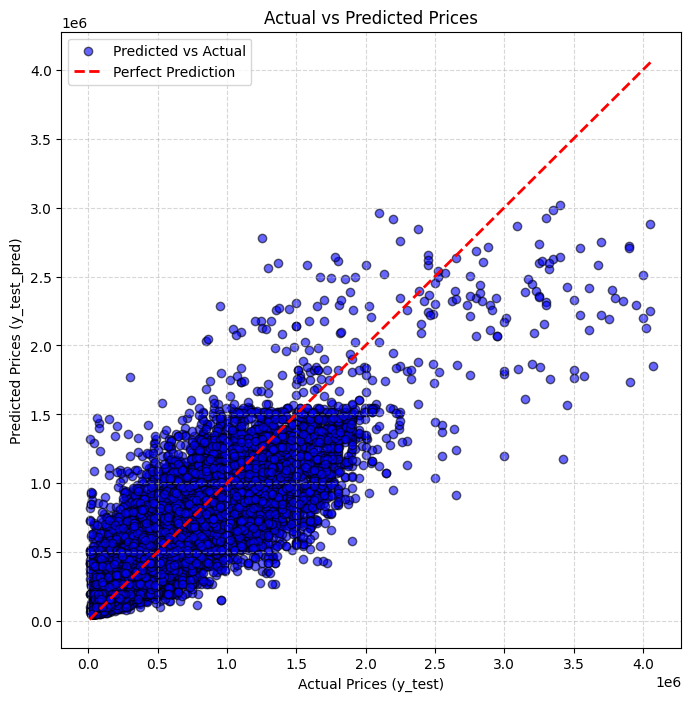

In [32]:
plt.figure(figsize=(8, 8))
plt.scatter(y_test, y_test_pred, alpha=0.6, edgecolors='k', color='blue', label="Predicted vs Actual")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--', lw=2, label="Perfect Prediction")
plt.title("Actual vs Predicted Prices")
plt.xlabel("Actual Prices (y_test)")
plt.ylabel("Predicted Prices (y_test_pred)")
plt.legend()
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

In [33]:
hp.to_csv('main_file2.csv',index=False)